# Homework: Texture Synthesis and Hole Filling

### In this homework we will implement the algorithm originated from the paper "Texture Synthesis by Non-Parametric Sampling"

### The formulation of the problem.

Let we have an image $I\in\mathbb{R}^{H\times W\times 3}$ and a binary mask $M\in \{0,1\}^{H\times W}$. Suppose the pixels of $I$ which are marked by $1$ in the binary mask $M$ are unknown, i.e. we do not know the values $I_{ij}$ for every $i,j$ shuch that $M_{ij} = 1$ (and also we know all the values $I_{ij}$ for every $i,j$ such that $M_{ij}=0$).

The problem is $\textbf{to estimate the unknown values of}$ $I$.

## The algorithm

##### As you know the idea of the algorithm is to "fill the hole" in the image $I$ starting from its boundary points and iteratively fill until no unknown pixels of $I$ remain. So let's describe one iteration of this filling process, i.e. how we fill the boundary of the "hole" which is described by the image $M$ (the set of pixels (i,j), for which $M_{ij} = 1$, we call a "hole").

At first we need to understand what is the "boundary" of the "hole". This is the set of pixels $(i,j)$ for which $M_{ij} = 1$, but at least for one neighbor of $(i,j)$, say for $(i',j')$, $M_{i'j'} = 0$ (i.e. the pixel $(i,j)$ is on the boundary of the hole if and only if it belongs to the hole and has an 8-neighbor, which does not belong to the hole). We can obtain the boundary of the hole by the operations $\textbf{erosion}$ and $\textbf{dilation}$ (after the algorithm description you will implement it).

Then for each pixel $p_{bound}$ from the boundary of the hole we need to decide how to fill this pixel. For that we consider all $\textit{valid}$ pixels $p_{valid}$ (the set of the valid pixels is described below), and based on the $\textit{similarity}$ (described below) of the $\textit{neighborhoods}$ (described below) of the pixels $p_{bound}$ and $p_{valid}$ decide to fill or not the value of $p_{bound}$ with the value of $p_{valid}$ (naturally, the value of the pixel $p_{valid}$ should be known).

$\textbf{Description of the neighborhood of the pixel:}$ The pixels which are in the window of size $(k_{N}, k_{N})$ centered in the pixel $p$, we call the $\textit{neighborhood}$ of $p$. This neighborhood of $p$ we will denote by $\omega(p)$.

$\textbf{Description of the set of the valid pixels:}$
As in the most of cases in the image the hole is supposed to be similar to its neighborhood, we can search pixels $p_{valid}$ only in some neighborhood of the hole. For example we can define a neighborhood of the hole by dilating it with a parameter $\textit{kernel_size} = k_{valid}$ (next it will be clear that $k_{valid}$ must be larger or equal than $k_{N}$). Then, we need to get from this (dilated) neighborhood only the pixels $p_{valid}$, vor which all the pixels of its neighborhood are known (i.e. we need to chose the pixels $p_{valid}$ among the pixels of the obtained neighborhood (i.e. neighborhood of the hole), such that the neighborhood of $p_{valid}$ has no intersection with the hole). All the chosen pixels are called $\textbf{valid}$ pixels.

$\textbf{Description of the similarities of image patches:}$ As you can see, for each boundary pixel $p_{bound}$ and for each valid pixel $p_{valid}$ we need to compare the image patches $\omega(p_{bound})\in \mathbb{R}^{k_N\times k_N\times 3}$ and $\omega(p_{valid})\in \mathbb{R}^{k_N\times k_N\times 3}$. We say two patches are similar if the $\textit{distance}$ between them is small. So we need to define some distance. In this implementation we use $\textit{SSD (sum of squared differences)}$ of $\textit{the known parts}$ of patches, divided on the number of known pixels of the patch $\omega(p_{bound})$. So, 
$$
dist(\omega(p_{bound}), \omega(p_{valid})) = \frac{1}{|K|}\sum_{(i,j)\in K}(\omega(p_{bound})_{i,j} - \omega(p_{valid})_{i,j})^2,
$$
where $K$ is the set of known pixels in the patch $\omega(p_{bound})$.

Now we are ready for the algorithm description:
- while the hole exists
    - find the boundary of the hole
    - find the set of valid pixels
    - for pixels $p_{bound}$ on the boundary of the hole
        - for all valid pixels $p_{valid}$
            - compute the scores $dist(\omega(p_{bound}), \omega(p_{valid}))$
        - find the minimal score $s_{min}$
        - find all valid pixels $p_{valid}$, such that $dist(\omega(p_{bound}), \omega(p_{valid})) \leq s_{min} + \varepsilon \; $ (for some predefined $\varepsilon$)
        - randomly chose one of these pixels
        - fill the value of the pixel $p_{bound}$ with the value of the chosen pixel.
    - update the hole 



### Note! 

In the main part of this homework don't worry about the cases when patches are out of the image. Handle these cases in the supplementary part.

In [1]:
from scipy.signal import convolve2d
import matplotlib.pyplot as plt
from time import time
from tqdm import tqdm
import numpy as np
import cv2

In [2]:
%matplotlib inline

### The Main Part

#### Read an image and generate a mask

In [3]:
img = cv2.imread('hole_filling.jpg')[:,:,::-1]
img = cv2.resize(img, (512, 512))/255.

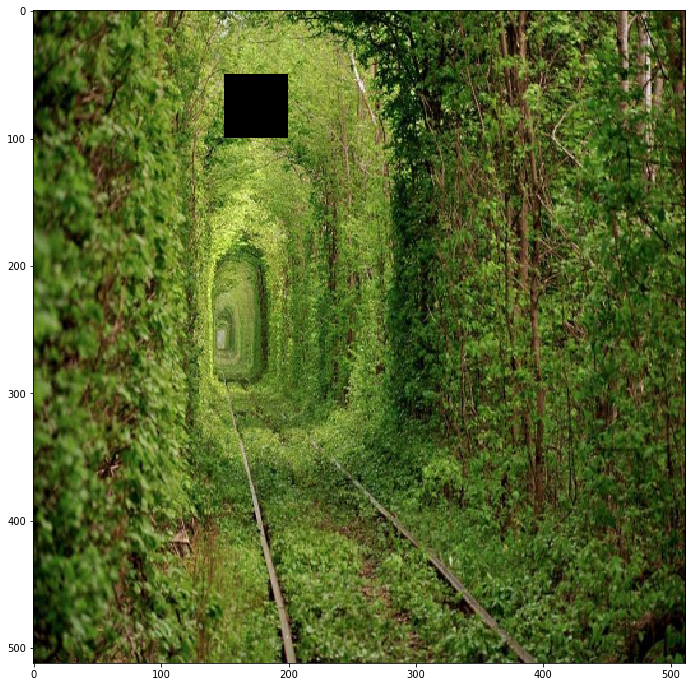

In [4]:
mask_to_fill = np.zeros_like(img[:,:,0])
mask_to_fill[50:100,150:200] = 1.0

# For convenience we will stack the hole to get 3-channeled image
mask_to_fill = np.stack([mask_to_fill]*3, axis=-1)

crop_mask = cv2.dilate(mask_to_fill, np.ones((31,31))) # This is the neighborhood of the hole

# visualize the image with hole
img_with_hole = img.copy()
img_with_hole[mask_to_fill == 1] = 0

plt.figure(figsize=(12,12))
plt.imshow(img*(1.0 - mask_to_fill))

#### How to get the boundary of the hole?

In [5]:
def get_boundary(mask):
    inner_part = cv2.erode(mask, np.ones((3,3)))
    
    return mask - inner_part

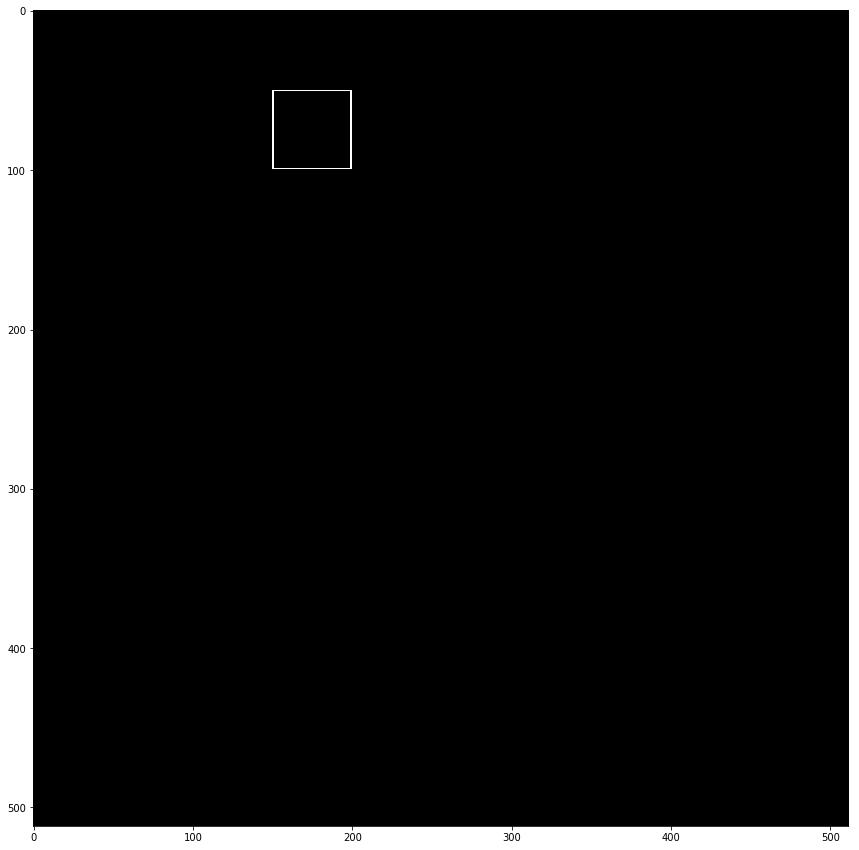

In [6]:
plt.figure(figsize=(15,15))
plt.imshow(get_boundary(mask_to_fill));

#### Define some parameters

In [7]:
kernel_radius = 12
kernel_size = 2*kernel_radius + 1
kernel = np.ones((kernel_size, kernel_size))

eps = 0.0

#### You can use this auxiliary function, in order to find the pixels of the hole. 

In [8]:
def get_where_indices(arr):
    arr = np.where(arr)
    return np.array([[arr[0][i], arr[1][i]] for i in range(len(arr[0]))])

#### The sum of squared differences

In [9]:
def ssd(arr1, arr2):
    return np.sum((arr1 - arr2)**2)

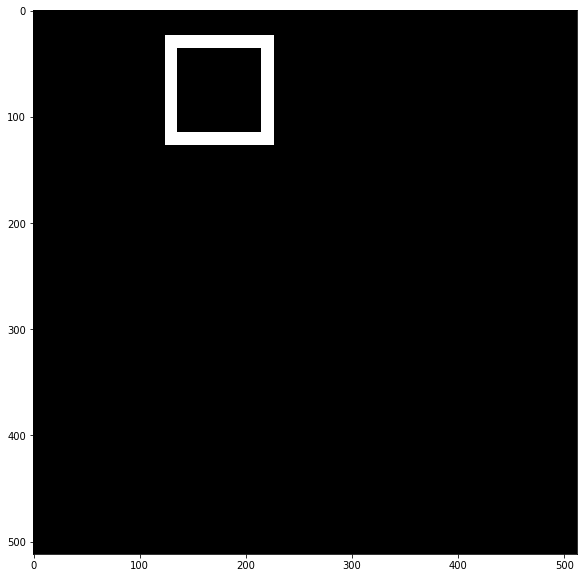

In [10]:
crop_mask = cv2.dilate(mask_to_fill, np.ones((30,30)))
crop_mask2 = cv2.dilate(crop_mask, np.ones((kernel_size,kernel_size)))

mask_to_get_valid = crop_mask2 - crop_mask



plt.figure(figsize=(10,10))
plt.imshow(mask_to_get_valid)

In [6]:
def fill_the_boundary(img, mask_to_fill, kernel_radius = 10, eps = 1e-3):
    img_ = img.copy()
    kernel_size = 2*kernel_radius + 1
    kernel = np.ones((kernel_size, kernel_size))
    
    boundary = get_boundary(mask_to_fill)

    # obtain an image with values from {0, 1} 
    # such that mask_to_get_valid[i,j,0] = 1 if and only if the pixel (i,j) is a valid pixel
    crop_mask = cv2.dilate(mask_to_fill, np.ones((kernel_size, kernel_size)))
    crop_mask_expanded = cv2.dilate(crop_mask, np.ones((30,30)))
    mask_to_get_valid = crop_mask_expanded - crop_mask

    # This tensor will help with determining the distances between patches. 
    count_tensor = convolve2d(1.0 - mask_to_fill[:,:,0], np.ones((kernel_size, kernel_size)), mode = 'same')
    # The element count_tensor[i,j] shows the number of known pixels in the patch \omega((i,j))

    masked_img = img_*(1.0-mask_to_fill)
  
    where_to_fill = get_where_indices(boundary[:,:,0])
    where_to_get = get_where_indices(mask_to_get_valid[:,:,0])

    for ind_fill in tqdm(where_to_fill):
        i, j = ind_fill
        # get the patch centered in the pixel (i,j) and with the size (kernel_size, kernel_size)
        patch_to_replace = masked_img[i-kernel_radius:i+kernel_radius+1, j-kernel_radius:j+kernel_radius+1]     

        # get the mask such that patch_mask[u,v] = 1 if and only if the pixel (u,v) is known in the patch patch_to_replace
        patch_mask = patch_to_replace.copy()
        patch_mask[patch_mask > 0] = 1.0
        
        scores = []

        for idx_get in range(where_to_get.shape[0]):
            i_get, j_get = where_to_get[idx_get]
          
            # get the patch centered in the pixel (i_get,j_get) and with the size (kernel_size, kernel_size)
            patch_to_get = masked_img[i_get-kernel_radius:i_get+kernel_radius+1, j_get-kernel_radius:j_get+kernel_radius+1]
            patch_to_get_masked = patch_mask*patch_to_get
            # compute the distance of patches patch_to_get and patch_to_replace
            score = ssd(patch_to_get_masked, patch_to_replace)/count_tensor[i_get, j_get]
            scores.append(score)
        
        # randomly choose a valid pixel (i_match, j_match) such that dist(ω((i,j)),ω((i_match, j_match))) ≤ min(scores) + ε
        scores = np.array(scores)
       
        indexes = np.where(scores <= np.min(scores) + eps)[0]
        i_match, j_match = where_to_get[np.random.choice(indexes)]
        
        # fill the value (i.e. replace zeros) of $(i,j)$ with the value of (i_match, j_match)
        masked_img[i,j] = masked_img[i_match, j_match]
  
    # update the mask_to_fill, since the boundary of the hole is already filled     
    mask_to_fill = mask_to_fill - boundary
    
    return masked_img, mask_to_fill
            

100%|██████████| 196/196 [00:11<00:00, 16.74it/s]


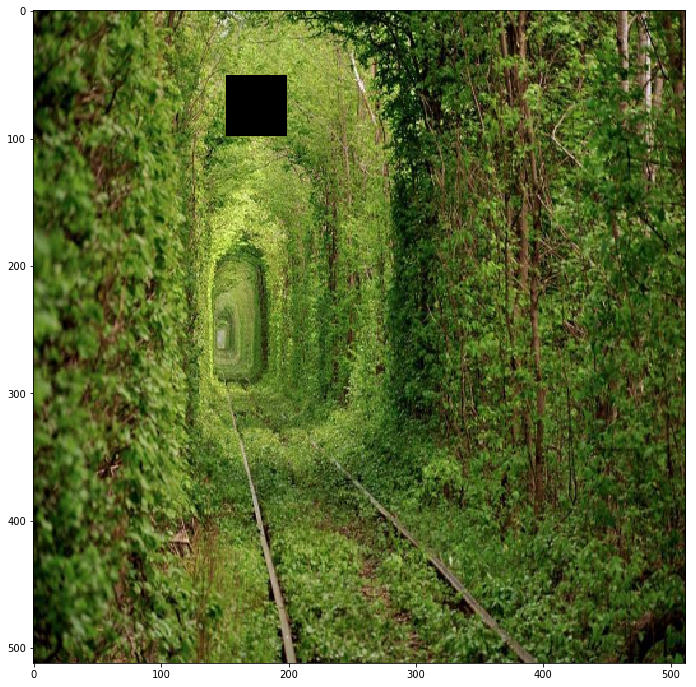

100%|██████████| 188/188 [00:10<00:00, 17.14it/s]


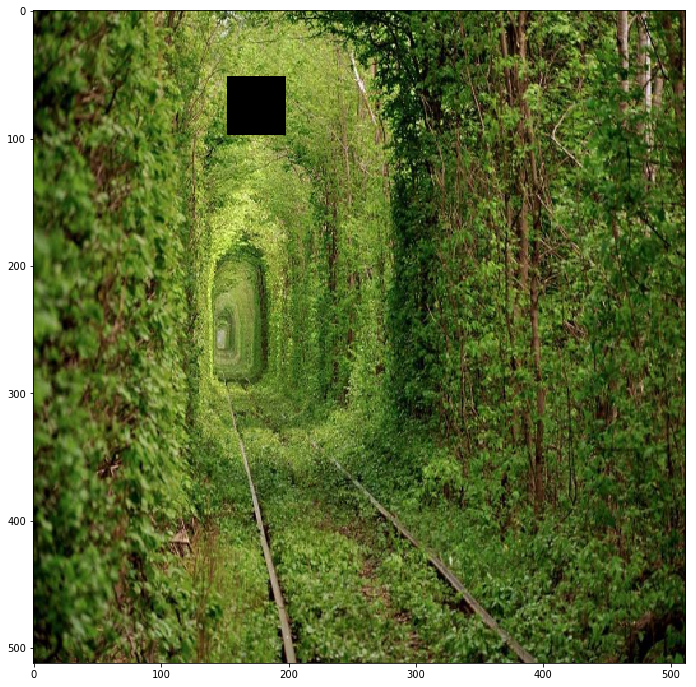

100%|██████████| 180/180 [00:10<00:00, 17.61it/s]


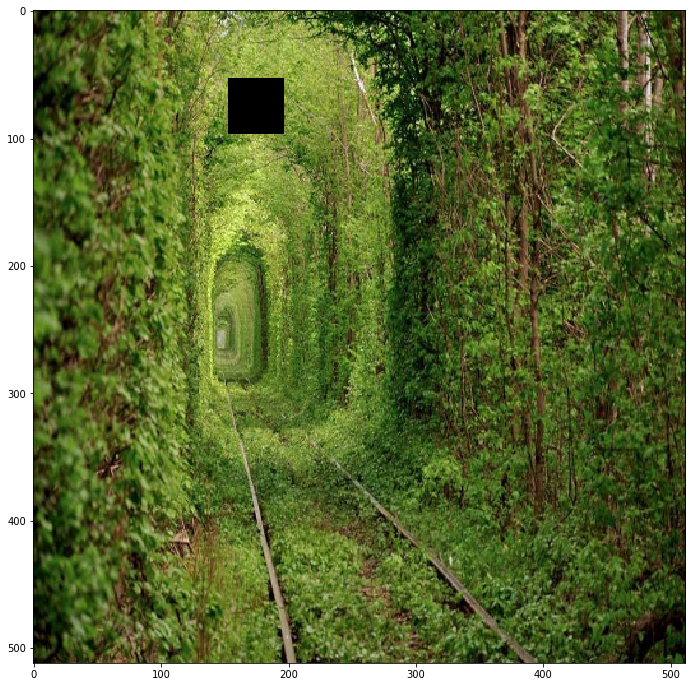

100%|██████████| 172/172 [00:09<00:00, 18.06it/s]


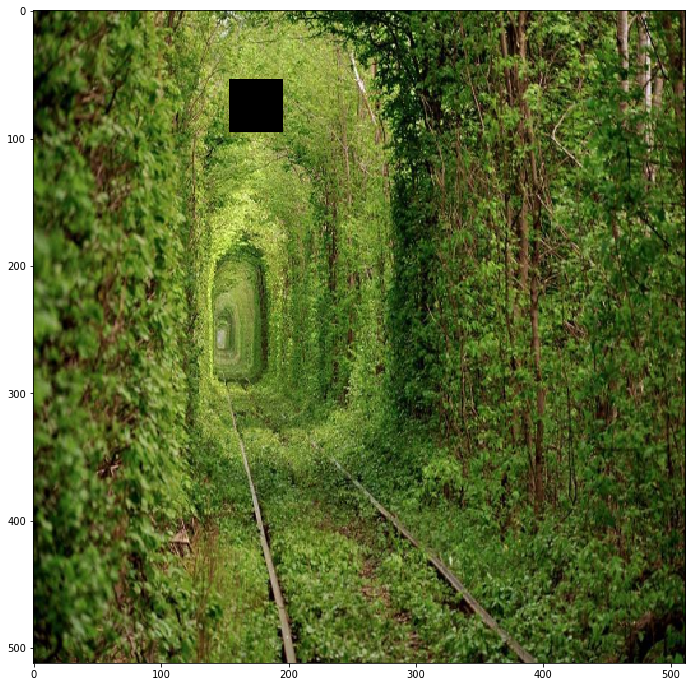

100%|██████████| 164/164 [00:08<00:00, 18.54it/s]


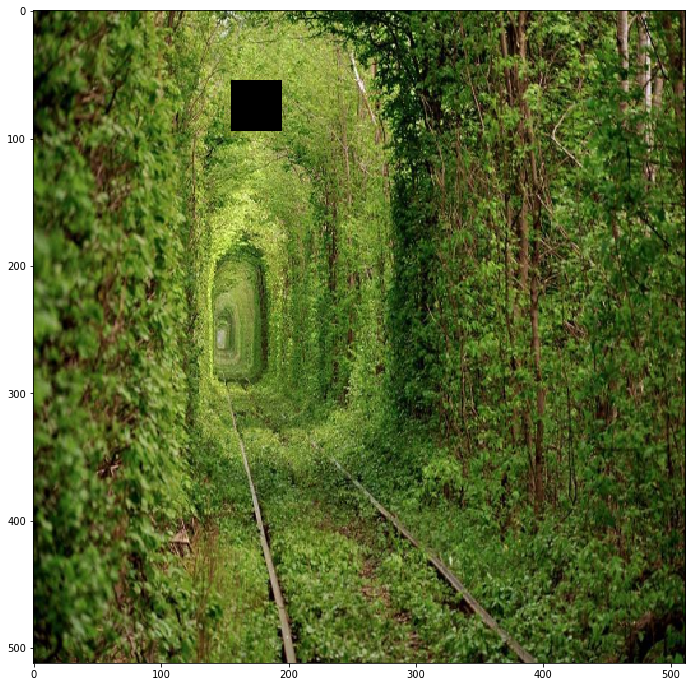

100%|██████████| 156/156 [00:08<00:00, 18.83it/s]


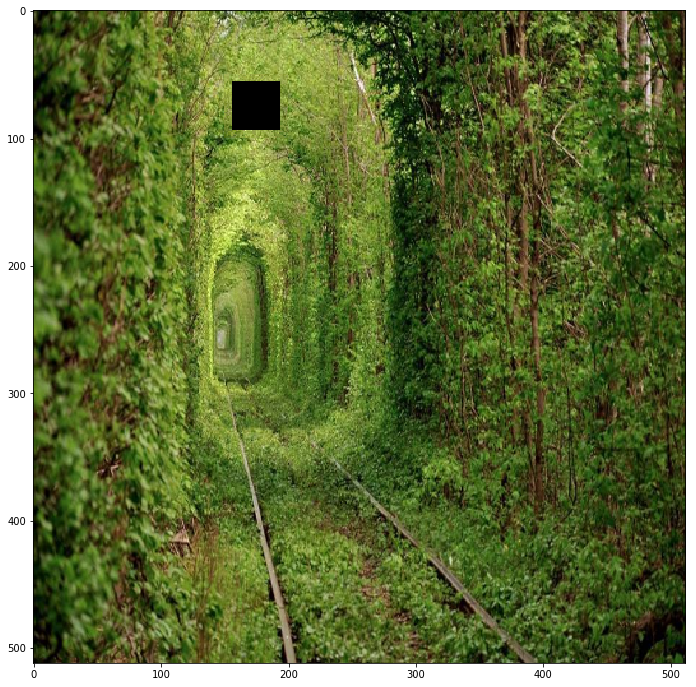

100%|██████████| 148/148 [00:07<00:00, 19.27it/s]


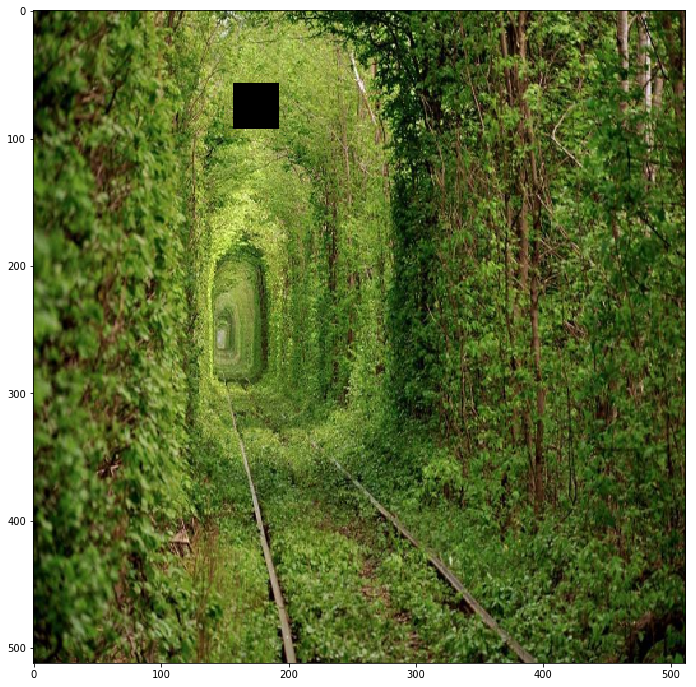

100%|██████████| 140/140 [00:07<00:00, 19.74it/s]


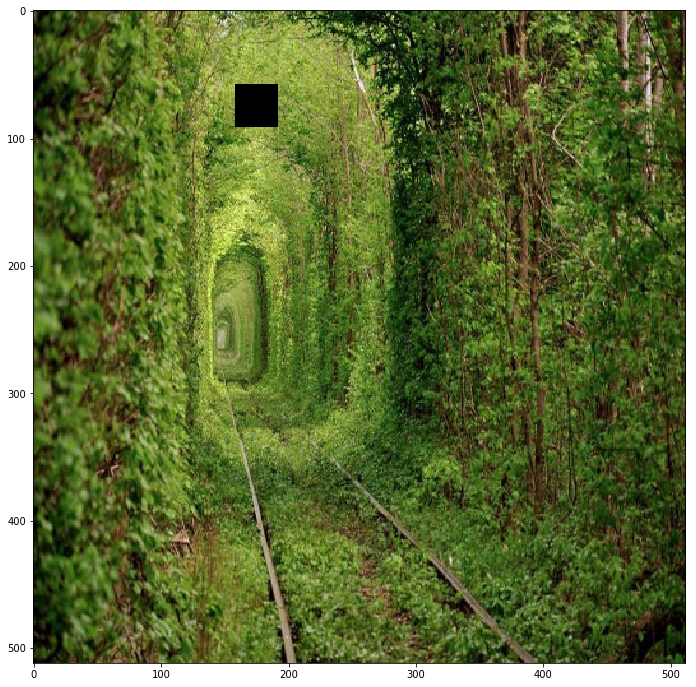

100%|██████████| 132/132 [00:06<00:00, 20.37it/s]


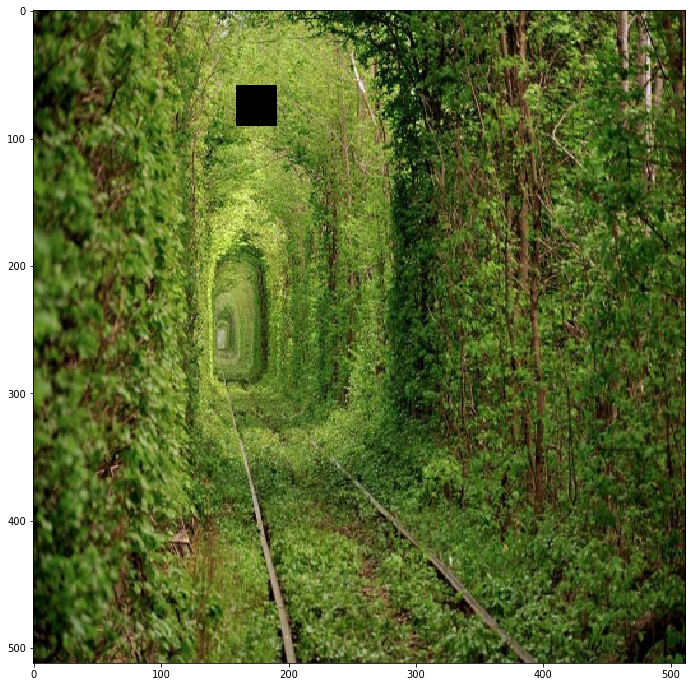

100%|██████████| 124/124 [00:05<00:00, 20.98it/s]


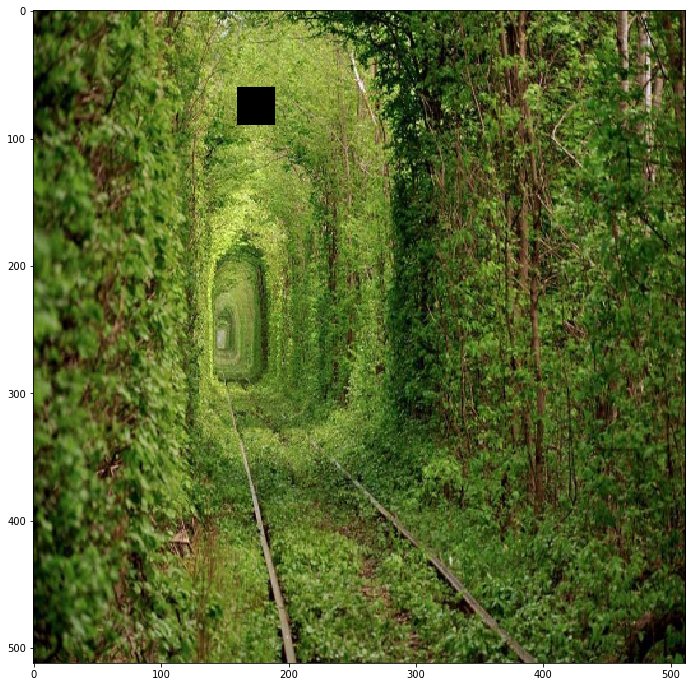

100%|██████████| 116/116 [00:05<00:00, 21.38it/s]


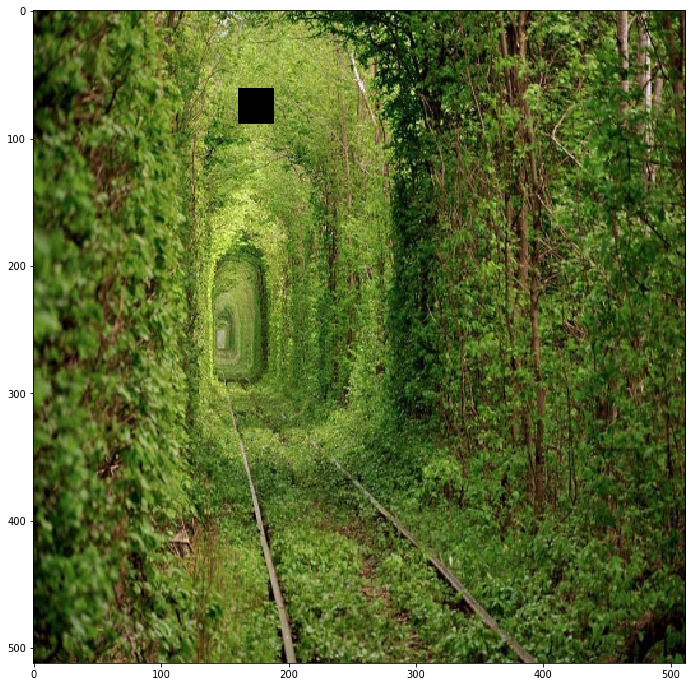

100%|██████████| 108/108 [00:04<00:00, 22.38it/s]


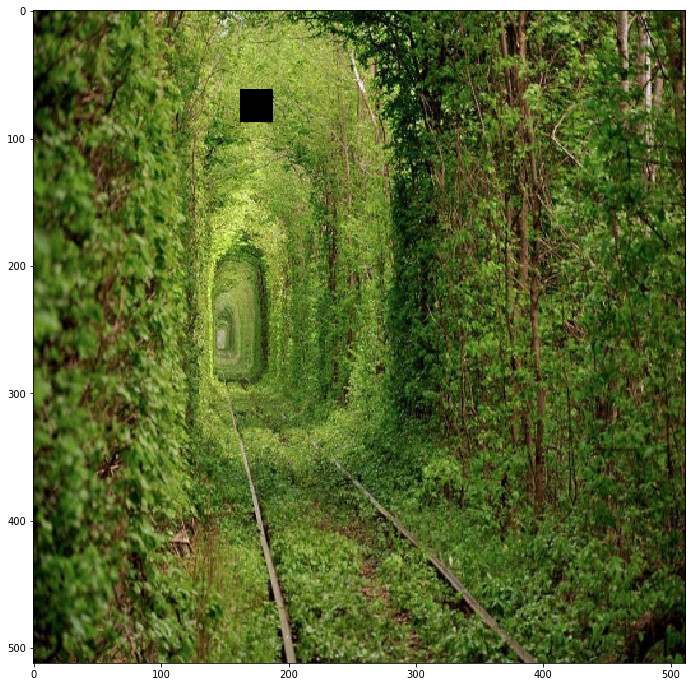

100%|██████████| 100/100 [00:04<00:00, 22.47it/s]


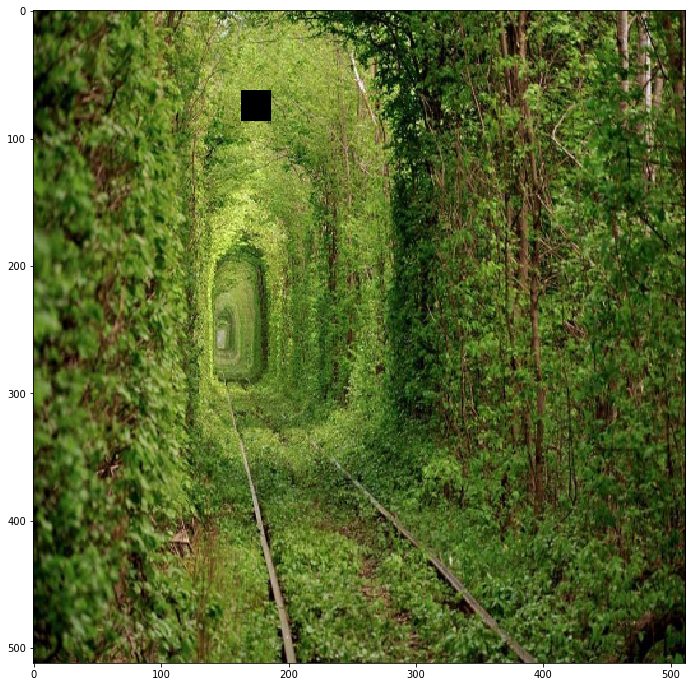

100%|██████████| 92/92 [00:03<00:00, 23.30it/s]


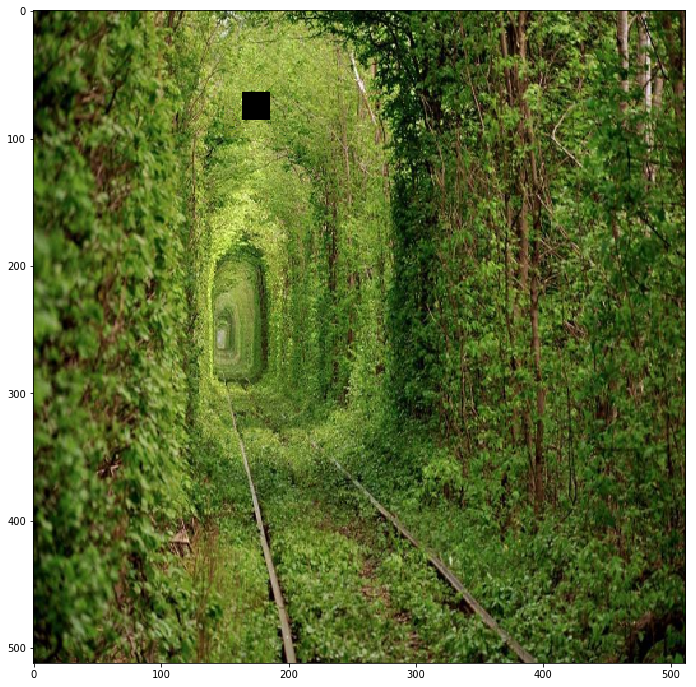

100%|██████████| 84/84 [00:03<00:00, 24.06it/s]


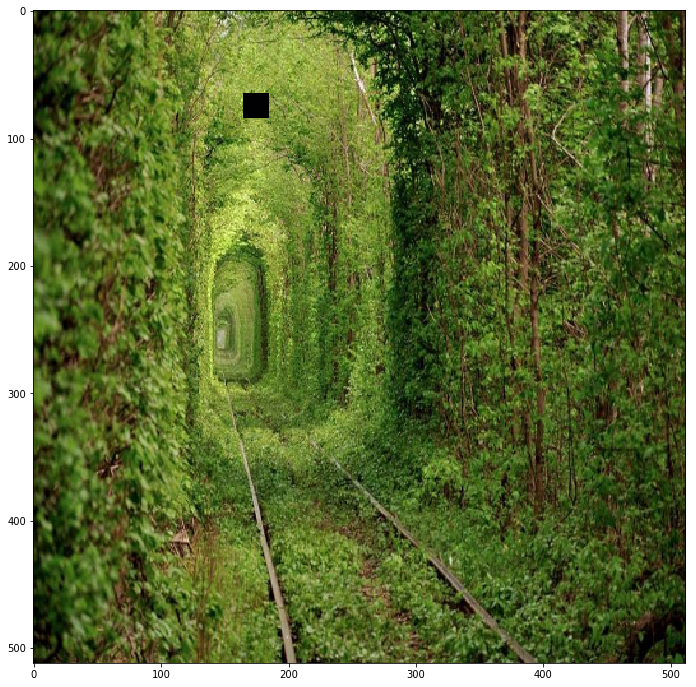

100%|██████████| 76/76 [00:02<00:00, 25.34it/s]


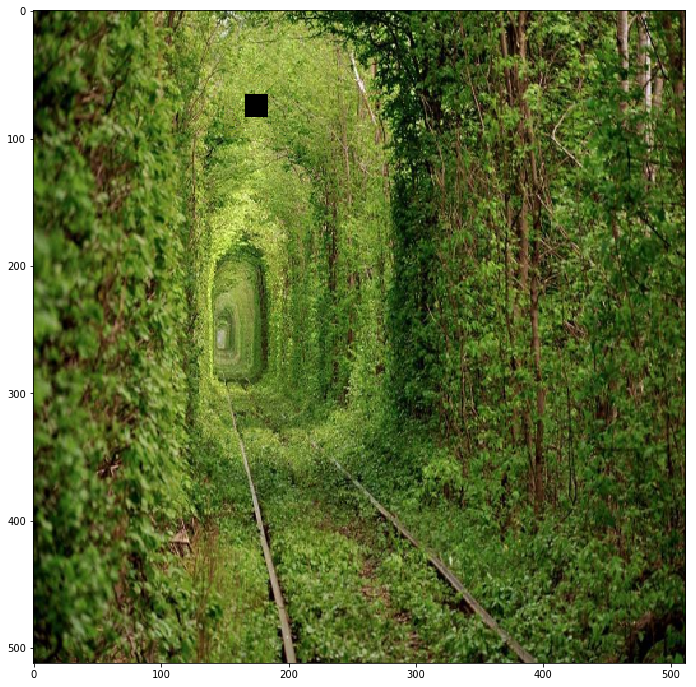

100%|██████████| 68/68 [00:02<00:00, 26.42it/s]


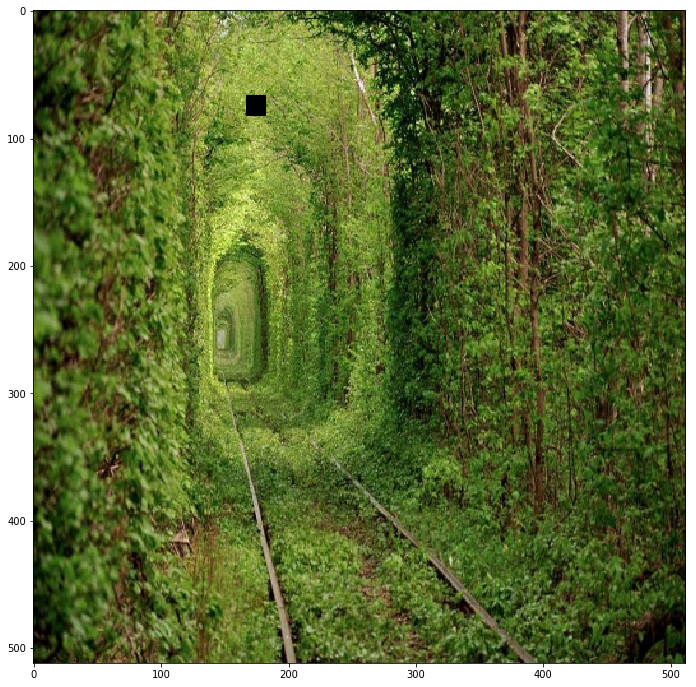

100%|██████████| 60/60 [00:02<00:00, 26.45it/s]


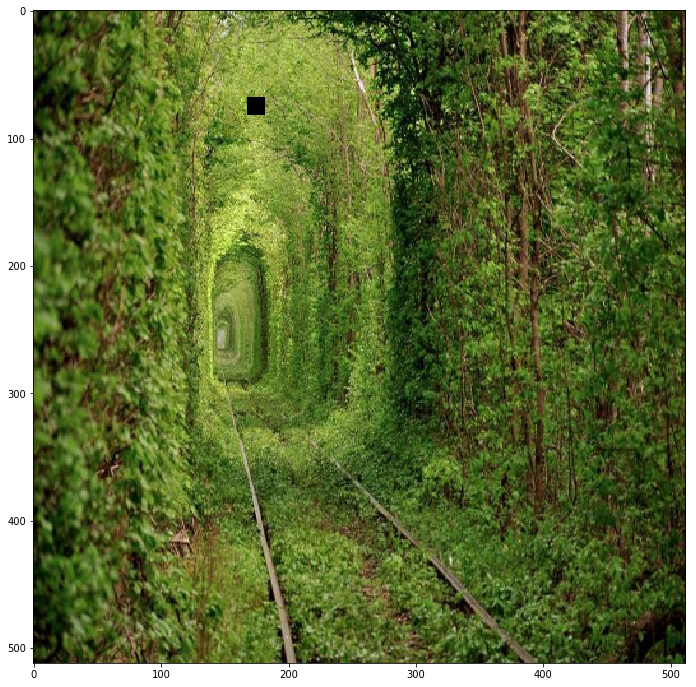

100%|██████████| 52/52 [00:01<00:00, 28.35it/s]


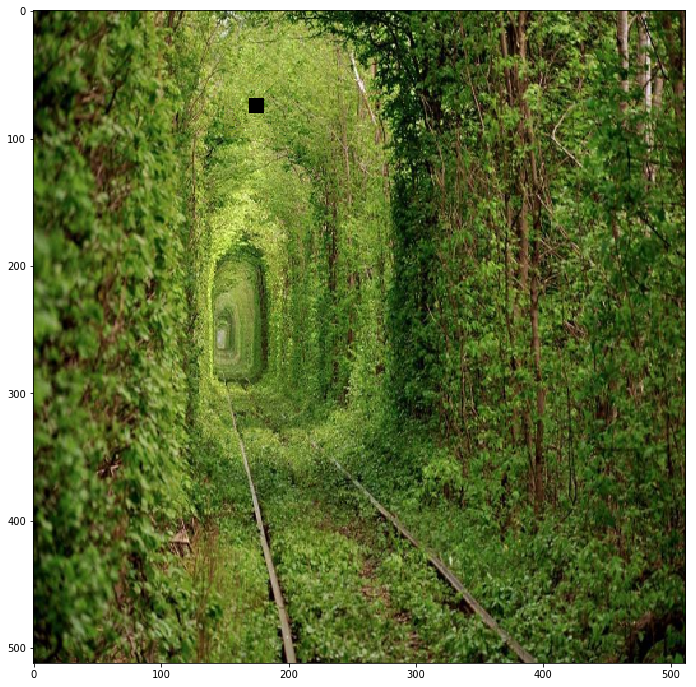

100%|██████████| 44/44 [00:01<00:00, 29.56it/s]


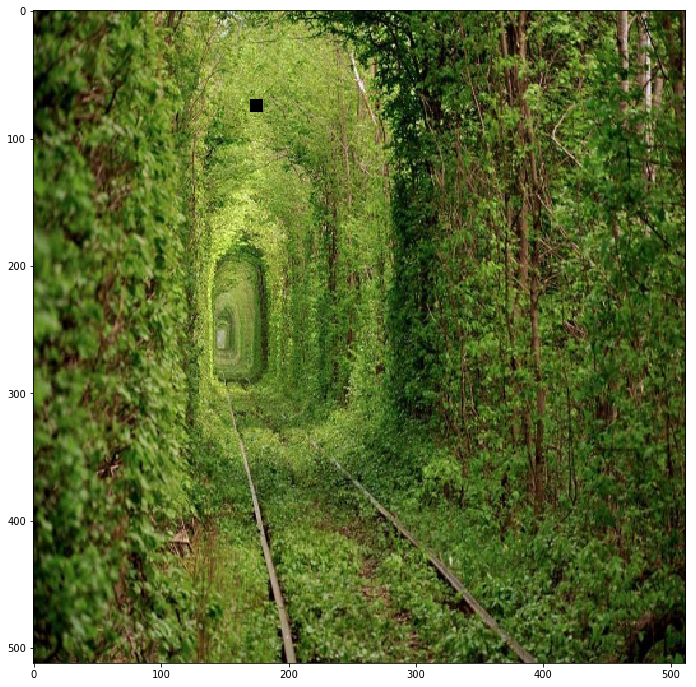

100%|██████████| 36/36 [00:01<00:00, 30.20it/s]


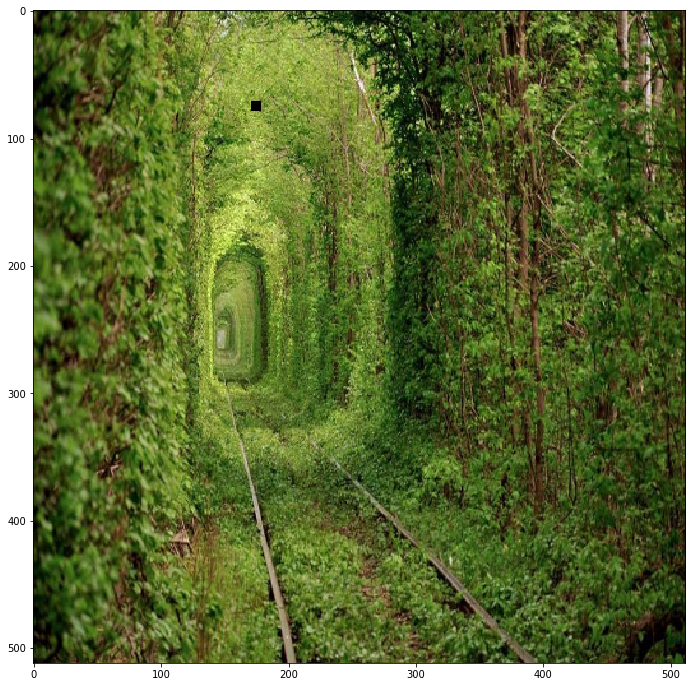

100%|██████████| 28/28 [00:00<00:00, 31.85it/s]


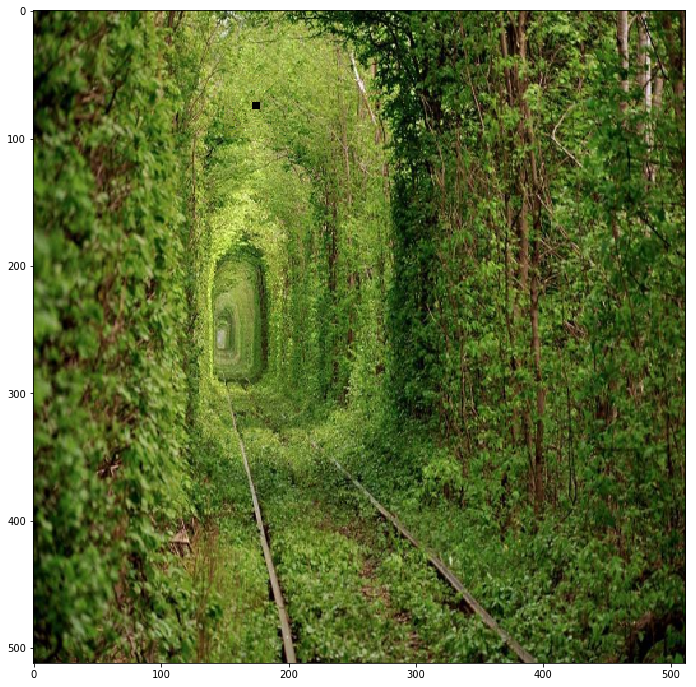

100%|██████████| 20/20 [00:00<00:00, 33.10it/s]


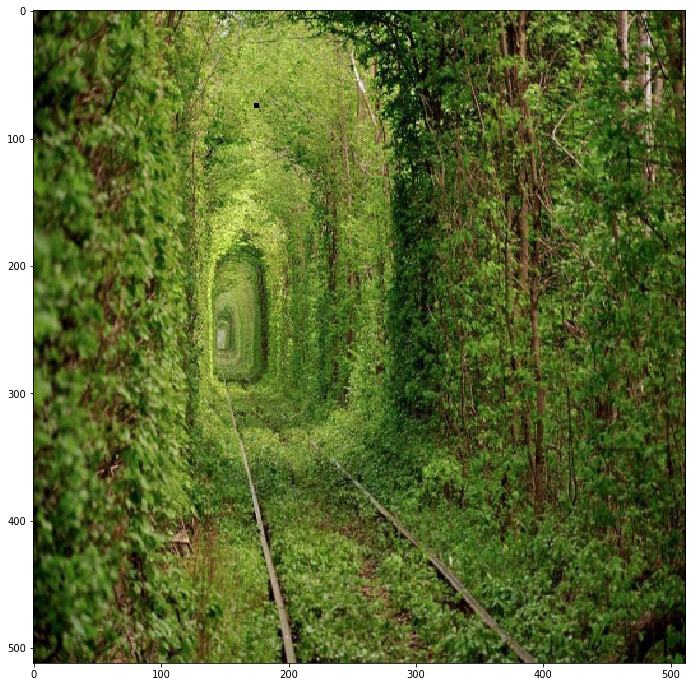

100%|██████████| 12/12 [00:00<00:00, 35.29it/s]


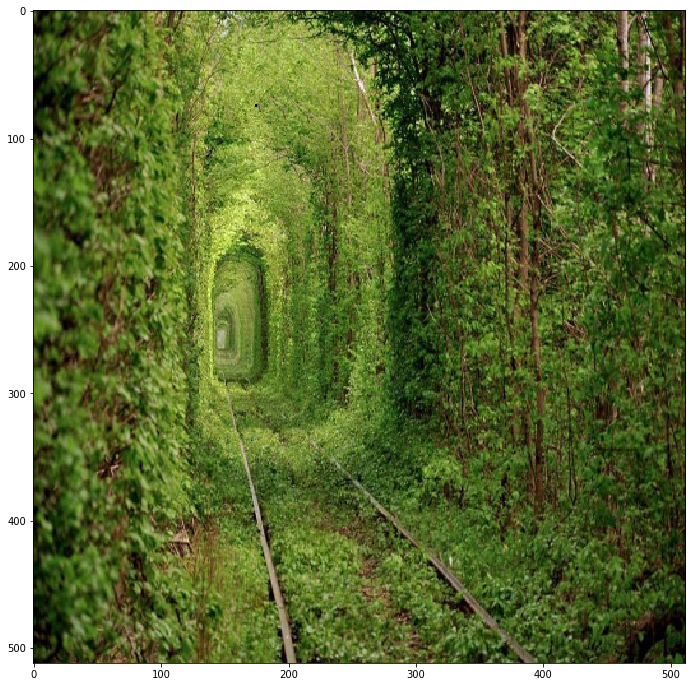

100%|██████████| 4/4 [00:00<00:00, 35.60it/s]


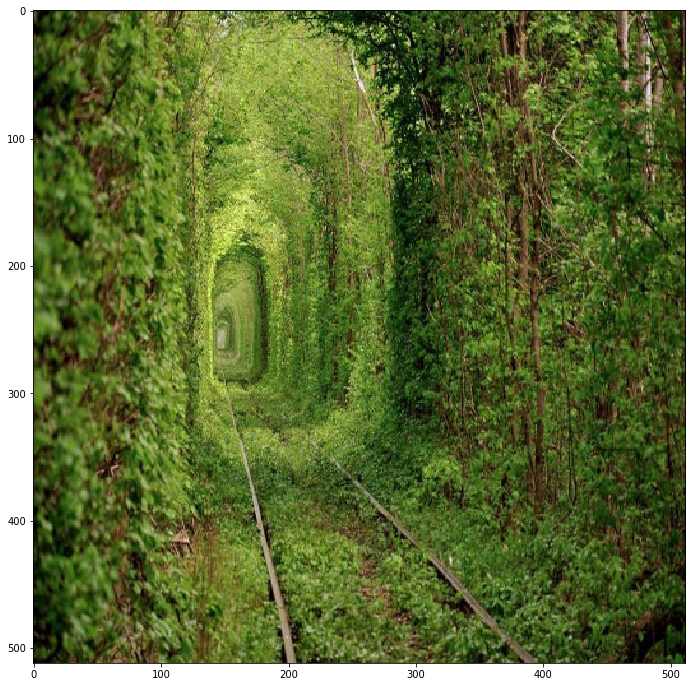

138.7437219619751


In [12]:
res = img.copy()
res_mask_to_fill = mask_to_fill.copy()
start = time()
while res_mask_to_fill[:,:,0].sum() != 0:
    res, res_mask_to_fill = fill_the_boundary(res, res_mask_to_fill, kernel_radius = kernel_radius, eps = eps)
    plt.figure(figsize = (12,12))
    plt.imshow(res)
    plt.show()
print(time()-start)

### The Supplementary Part

Modify the function $\textbf{fill_the_boundary}$ to handle with the cases when considered patches are out of the image. 